### Advanced Lane Finding Project

The goals / steps of this project are the following:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images. 
2. Apply a distortion correction to raw images.
3. Use color transforms, gradients, etc., to create a thresholded binary image.
4. Apply a perspective transform to rectify binary image ("birds-eye view").
5. Detect lane pixels and fit to find the lane boundary.
6. Determine the curvature of the lane and vehicle position with respect to center.
7. Warp the detected lane boundaries back onto the original image.
8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

### Code:
- camera_calibration.py - code to calibrate camera using chess board images
- image_utils.py - helper code to work with images. Also has code to convert image to binary using hls transformation and sobel
- perspective_transform.py - code to convert image to birds eye view and back
- lane_finding_histogram.py - code to identify lanes using histogram approach. Also has code to compute lanes by using lane information from previous frame
- lanes.py - code to keep track of left and right lanes for the past N frames. Also has code to smoothen lanes using historic lane information.
- lane_detection.py - pipeline is defined here
- pipeline_debugger.py - code to generate required output images and video

### Outputs
- output images with lanes marked are in output_images/
- output video with lanes marked is output_videos/marked_project_video.mp4


In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import glob

from camera_calibration import CameraCalibrator, plot_single_camera_image_using_calibrator
from lane_detection import LaneDetectionPipeline
from image_utils import *
from perspective_transform import BirdsEyeViewTransform
from lane_finding_histogram import *


### Camera Calibration:

Most of the chessboard camera images have 9x6 visible corners, except a couple which only have 9x5 visible corners.

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image. Thus, objp is just a replicated array of coordinates, and objpoints will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.

imgpoints will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

I then used the output objpoints and imgpoints to compute the camera calibration and distortion coefficients using the cv2.calibrateCamera() function. Calibration matrix and distortion are saved to models/camera_calibration_model.

In the code below, I am loading the calibration model to memory, and displaying chess board images post distortion and perspective transformation.

In [2]:
calibrator = CameraCalibrator()
calibrator.restore('models/camera_calibration_model')

calibration model restored from models/camera_calibration_model


#### Here are some of the results of applying distortion correction chessboard images:

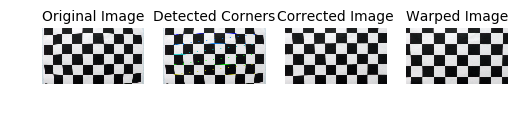

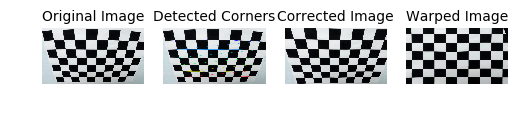

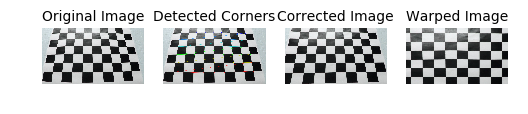

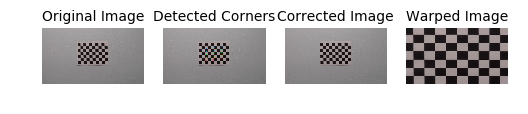

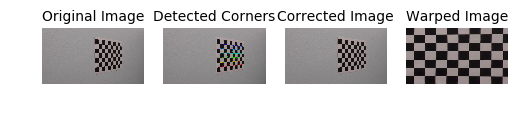

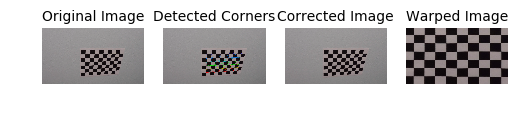

In [3]:
sample_camera_images_and_corners = [
        (cv2.imread('camera_cal/calibration1.jpg'), 9, 5),
        (cv2.imread('camera_cal/calibration2.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration3.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration6.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration8.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration10.jpg'), 9, 6)]

for img, nx, ny in sample_camera_images_and_corners:
    plot_single_camera_image_using_calibrator(img, nx, ny, calibrator)
    plt.show()

In [4]:
## helper to display image grid
def grid_plot(image_cols):
    ncols = len(image_cols)
    nrows = len(image_cols[0][1])
    fig, axes = plt.subplots(nrows, ncols, figsize = (8*ncols, 4*nrows))
    fig.tight_layout()
    fig.subplots_adjust(wspace = 0.1, hspace=0.1, )

    for r, ax in enumerate(axes):
        for c, (colname, imgs) in enumerate(image_cols):
            img = imgs[r]
            cmap = plt.cm.gray if img.ndim < 3 else None
            ax[c].imshow(img, cmap=cmap)
            ax[c].set_axis_off()
            ax[c].set_title(colname)

### Pipeline:

The pipeline I am using to process images and identify lanes contains these following steps:

1. Use camera calibration model and correct for distortion for the original image
2. Convert image to binary by applying a combination of HLS transform and gradients using sobel
3. Apply a mask that covers approximately the lane infront of the vehicle
4. Convert the binary image to birds eye view by applying perspective transformation
5. Using histogram based approach, identify pixels for left and right lanes
6. Fit a second degree polynomial to describe left and right lanes
7. Keep track of lanes for the last 5 frames and smoothen the lanes
8. Using lane information from previous frame, restrict the lookup area to identify the lanes in the new frame. Use histogram based approach only as fallback.
9. Compute radius of curvate and vehicle offset for the lane
10. Draw lanes and writeout relevant information about curvature and vehicle offset per frame in video

### Step 1: Distortion Correction

Here are results of applying distortion correction on test road images:

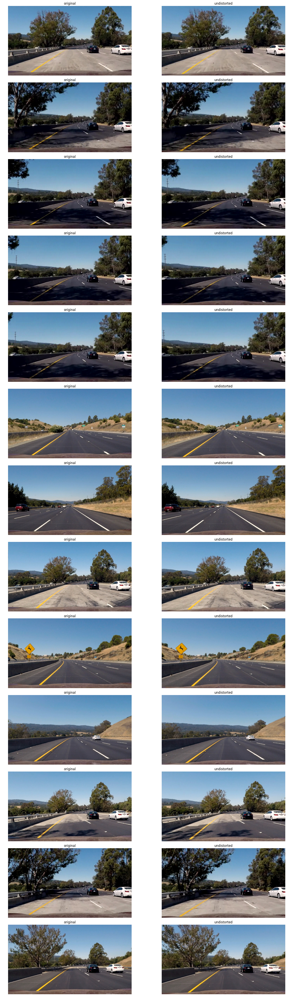

In [5]:
test_img_files = glob.glob("test_images/*.jpg")
test_images = [read_image_as_rgb(f) for f in test_img_files]
undist_images = [calibrator.undistort(img) for img in test_images]
grid_plot( [("original", test_images), 
           ("undistorted", undist_images)])

### Step 2: HLS transform and gradient
After correcting image for distortion, I am applying HLS transformation. 

Step 2.1: Over L channel, I am applying a gradient along X-axis to extract lines that almost vertical. I am retaining only X-gradients that are between (20, 100). These are depicted in blue in images in second column below.

Step 2.2: Using a threshold over S channel's values, I am extracting pixels where S value is between (170, 255). Also, I am computing the gradient betwwen X-Y axis and retaining lines that have mod(tangent angle) between (30 degrees, 70 degrees). This is an attempt to retainlines which have tangents similar to left and right lanes. Pixes identified in this approach are displayed in green in second column.

Retaining pixels from step 2.1 and 2.2 yields a binary image shown in third column below.

### Step 3: Applying mask
There is a lot of useless information in the left over binary image - clouds in sky, trees etc...

I am applying a mask that covers the area that approximately contains lane infront of camera.
Images in 4th column are cropped images which are result of applying mask on binary image.

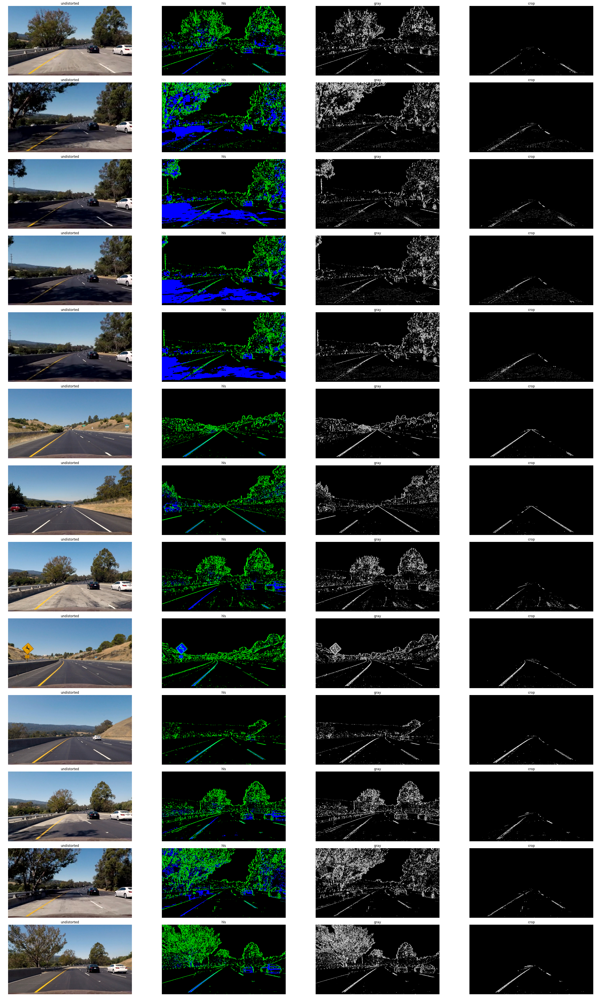

In [6]:
hls_transforms = [get_hls_transform_image(img, kernel_size =9) for img in undist_images]
custom_gray_transforms = [custom_gray_transform(img) for img in undist_images]
crops = [trapezoidal_crop(img) for img in custom_gray_transforms]
grid_plot([("undistorted", undist_images), 
            ("hls", hls_transforms),
            ("gray", custom_gray_transforms),
            ('crop', crops)
           ])

### Step 4: Perspective transformation / Birds eye view
Using cv2.warpPerspective, I am changing perspective of the binary image so that we can get a bird's eye view of the lanes.
Here is the mapping between source and destination points I am using to apply perspective transformation.

| Source Points | Target Points |
|---------------|---------------|
|   (190, 720)  |   (225, 720)  |
|  (1130, 720)  |  (1100, 720)  |
|   (705, 460)  |   (1100, 0)   |
|   (575, 460)  |    (225, 0)   |

Below, the first column has undistorted images from camera. Second column is the result of applying birds eye transform over undistorted image. Third column is the result of applying birds eye transform over binary image.

Left and right lanes appear parallel after this perspective transformation. They both either swerve left or right, but remain parallel, like expected.


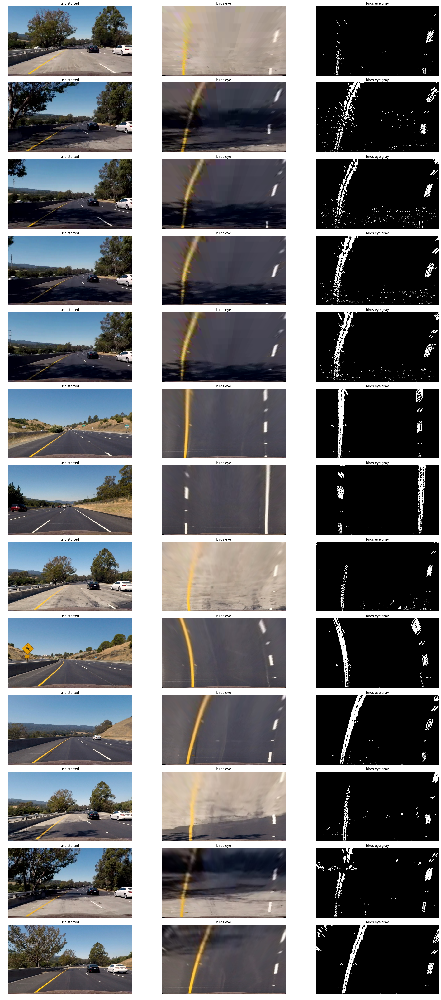

In [7]:
perspective_transformer = BirdsEyeViewTransform()

birds_eye_orig = [perspective_transformer.get_birds_eye_view(img) for img in undist_images]
birds_eye_gray = [perspective_transformer.get_birds_eye_view(img) for img in crops]

birds_eye_crops = [perspective_transformer.get_birds_eye_view(img) for img in crops]
grid_plot([("undistorted", undist_images), 
            ("birds eye", birds_eye_orig),
            ("birds eye gray", birds_eye_gray)
           ])

### Step 5: Using histogram based approach, identify pixels for left and right lanes
After applying calibration, thresholding, and a perspective transform to a road image, we have binary images where the lane lines stand out clearly. However, we still need to decide explicitly which pixels are part of the lines and which belong to the left line and which belong to the right line.

I first take a histogram along all the columns.

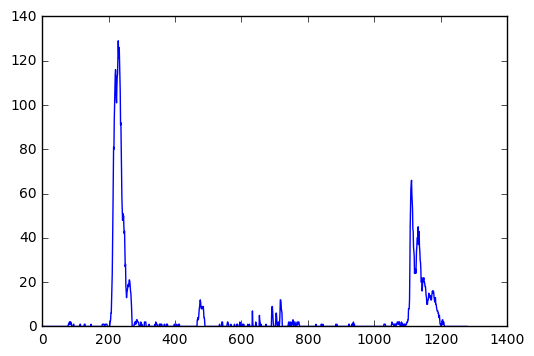

In [13]:
img = birds_eye_crops[0]
histogram = np.sum(img, axis=0)
plt.plot(histogram)
plt.show()

With this histogram I am adding up the pixel values along each column in the image. In my thresholded binary image, pixels are either 0 or 1, so the two most prominent peaks in this histogram will be good indicators of the x-position of the base of the lane lines. I can use that as a starting point for where to search for the lines. From that point, I can use a sliding window, placed around the line centers, to find and follow the lines up to the top of the frame.
In this sliding window, I keep track of all the idices for left and right lanes where the value in binary image is 1.

I am plotting these points that belong to left and right lanes in the third column below. Left lane points are marked in red, and right lane points are marked in blue.

### Step 6: Fit a second degree polynomial to describe left and right lanes
Now that we identified points that belong to left and right lanes separately, I try to fit a second degree polynomial for each lane.

In the 4th column, I am plotting the identified lane using second degree polynomial fit.


/code/carnd/Advanced-Lane-Detection/lane_finding_histogram.py:15: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  histogram = np.sum(binary_warped_img[binary_warped_img.shape[0] / 2:, :], axis=0)


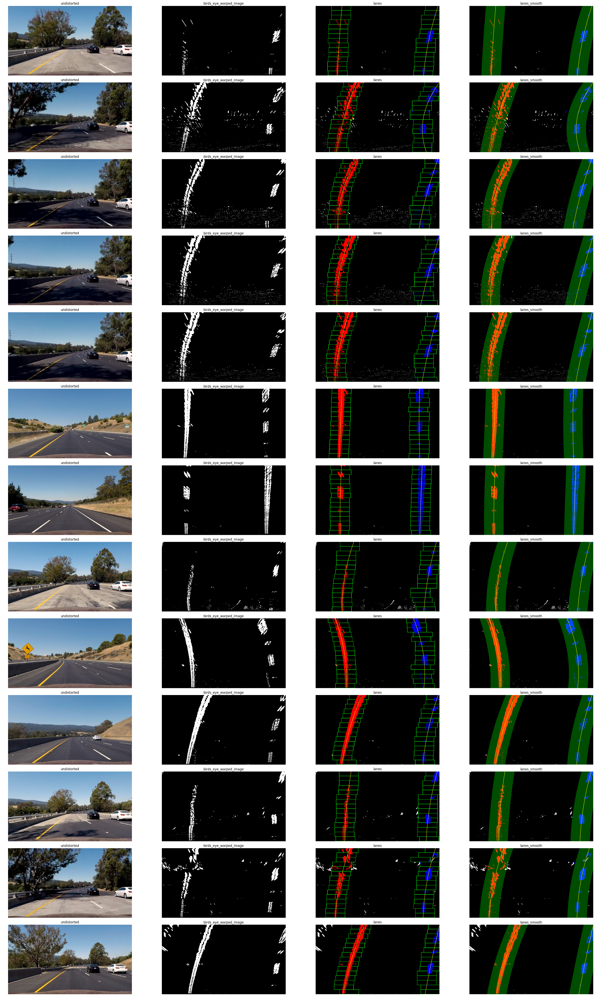

In [8]:
nrows = len(birds_eye_crops)
ncols = 4
fig, ax = plt.subplots(nrows, ncols, figsize = (8*ncols, 4*nrows))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for idx, binary_warped in enumerate(birds_eye_crops):
    ax[idx][0].imshow(undist_images[idx], cmap='gray') 
    ax[idx][0].axis("off")
    ax[idx][0].set_title("undistorted")

    ax[idx][1].imshow(binary_warped, cmap='gray') 
    ax[idx][1].axis("off")
    ax[idx][1].set_title("birds_eye_warped_image")

    plot_left_and_right_lanes(binary_warped, 15, ax[idx][2])
    ax[idx][2].axis("off")
    ax[idx][2].set_title("lanes")
    
    plot_left_and_right_lanes_smooth(binary_warped, 15, ax[idx][3])
    ax[idx][3].axis("off")
    ax[idx][3].set_title("lanes_smooth")

### Step 7: Keep track of lanes for the last 5 frames and smoothen the lanes
Inorder to have a smooth lane transition from each frame to next, I am keeping track of the lanes identified in last 5 frames, and averaging them to get the best fit for both left and right lane.
As a result, I have noticed that there is much less jumping of lanes in the video.

Also, I added some basic rules that the newly identified lane should adhere to:
- Distance between left and right lane should be similar at the bottom of the image and top. I compute the lane distance at several vertical intervals, and make sure that standard deviation is fairly low.
- Lane distance for this new frame should be similar to the lane distance in the last 5 images


### Step 8: Using lane information from previous frame, restrict the lookup area
If we already identified lanes in the last image, then there is an easier way to identify left and right lane points. Instead of computing histogram and using sliding windows to identify left and right lane points, i extract what non-zero points exist in binary image around the previously identified lane with a margin of 100 pixels on both sides.

And after fitting these identified points, I check if the new lane meets my pass criteria I mentioned earlier. If so, then this means we were able to use existing lane info from previous frame and lock lanes in new frame. This approach is much faster than sliding window approach.

If new lanes dont meet the pass criteria, then we lost the lane, and as a fallback I resort to histogram based sliding window approach and identify lane.

### Step 9: Compute radius of curvate and vehicle offset for the lane
#### Step 9.1: Radius of curvature
Now that we have best fit for left and right lanes, we want to compute radius of curvature.

Here is the scaling information per pixel (how many meters does a pixel corresponding to in real world) in each direction I am using for x and y. I am using these constants from class content

ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

Using this information, we convert points in pixel dimension to meters.
x_in_meters = x_in_pixel * xm_per_pix
y_in_meters = y_in_pixel * ym_per_pix

With this I fit another second degree polynomial in meter space, and compute radius of curvature using formula described in course content.

#### Step 9.2: Vehicle offset for the lane
Assuming that camera is mounted in the center of the car, center of car should always be represented by center_x_index
center_x_index = image_width / 2

Using left and right lane fits, I compute the x index for both left and right lane at the bottom of the image (left_x_bottom, right_x_bottom).

Center of lane is at lane_center_x_index = (left_x_bottom + right_x_bottom) / 2

The difference between center_x_index and lane_center_x_index is the vehicle offset from lanes in pixel. Multiplying that with xm_per_pix gives us vehicle offset in meters.

### Step 10: Draw lanes and writeout relevant information
Now that we have left and right lanes in birds eye view, we use cv2.getPerspectiveTransform and apply inverse transform to get camera's view of how the lanes look. I am also writing out the center lane's curvature, and vehicle offset on each frame. Apart from that I am writing if we were successful in identifying lanes by locking lanes from previous frame or if we lost the lane and had to resort to full histogram based sliding window approach.

Below are original camera images next to images where we plot lanes.

/code/carnd/Advanced-Lane-Detection/lane_finding_histogram.py:15: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  histogram = np.sum(binary_warped_img[binary_warped_img.shape[0] / 2:, :], axis=0)


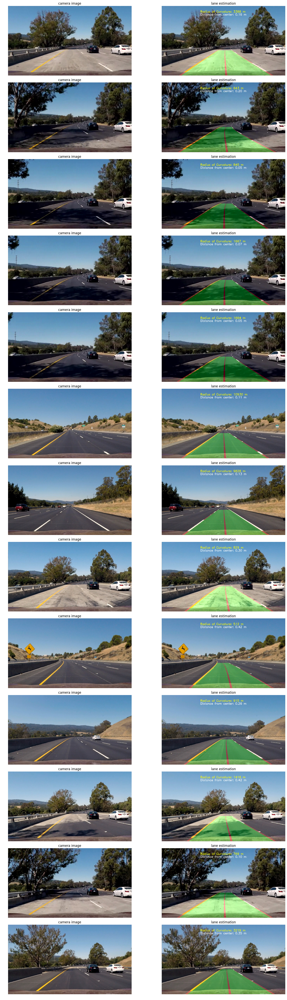

In [9]:
from lane_finding_histogram import fit_left_and_right_lanes
from lane_detection import LaneDetectionPipeline
from lanes import *

pipeline = LaneDetectionPipeline(calibrator)    
def get_img_with_lane_plotted(img):
    processed_img = pipeline.process(img)
    pipeline.reset()
    return processed_img

img_with_lanes = [get_img_with_lane_plotted(img) for img in test_images]

grid_plot([("camera image", test_images), 
            ("lane estimation", img_with_lanes)
           ])

    

#### Generating video file after marking lanes in project video:

In [10]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

clip_output_file = 'output_videos/marked_project_video.mp4'
clip = VideoFileClip("test_videos/project_video.mp4")
clip_output = clip.fl_image(pipeline.process)
%time clip_output.write_videofile(clip_output_file, audio=False)


[MoviePy] >>>> Building video output_videos/marked_project_video.mp4
[MoviePy] Writing video output_videos/marked_project_video.mp4


100%|█████████▉| 1260/1261 [03:41<00:00,  5.76it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/marked_project_video.mp4 

CPU times: user 14min 12s, sys: 1min 10s, total: 15min 23s
Wall time: 3min 42s


### Observations:
- From the video for project, I can see that lanes are identified clearly for the most part.
- I calculated the lane widths to be in the range 3.8 - 4.3m. This is not too far from average lane widths in USA.
- When car is going straight, the radius of curvature I computed in around 10,000m. When car is in a turn then this radius is in the range [500 m - 1000m]. This matches the real world radius of curvature for this specific turn as per course content.
- When we go over bridge and when we have strong shadows, there is still noise in binary image because some artifacts still creep in inspite of using HLS and applying gradient. As a result, there a a few frames in the video where identified lane doesn't perfectly fit. One way to fix them is by implementing a low pass filter.
- My pipeline doesnt work well with challenge video. Challenge video has a pronounced line betwwen left and right lanes that gets detected strongly. And because of that, the left and right lanes I identify in challenge video are not correct most of the time. One way to fix this is by masking out pixels around center of the image vertically.

Here's the link to video:
https://www.youtube.com/watch?v=6NTCl0pxKkU